# `Exploring the data`
Goal: To combine similar labels to decrease the number of classes

In [14]:
import pandas as pd 
import numpy as np
import seaborn as sn
import matplotlib.pyplot as plt
import seaborn as sns
import scipy as sp
import os
import json
import random
from PIL import Image
import IPython.display as display

In [15]:
df = pd.read_csv("trial_cleaning2.csv")

In [16]:
df.head()

,Unnamed: 0,name,object_classification,date,description,material,dynasty,path,location,period
0,0,ear-ring bead,ear-ring,1stc-3rdc,copper alloy ear-ring of thin wire with a loo...,copper alloy,NaN,bri_A_1880-3687-m.jpg,NaN,NaN
1,1,hair-pin dress-pin,hair-pin,1stc bc-early 1stc,copper alloy ornamental hair- or dress-pin he...,copper alloy,NaN,bri_A_1880-3711-o.jpg,NaN,NaN
2,2,hair-pin dress-pin,hair-pin,1stc bc-early 1stc,copper alloy ornamental hair- or dress-pin he...,copper alloy,NaN,bri_A_1880-3714-a.jpg,NaN,NaN
3,3,hair-pin dress-pin,hair-pin,1stc bc-early 1stc,copper alloy ornamental hair- or dress-pin he...,copper alloy,NaN,bri_A_1880-3717-f.jpg,NaN,NaN
4,4,ear-ring,ear-ring,1stc-3rdc,cast copper alloy hoop ear-ring bound with th...,copper alloy,NaN,bri_A_1880-3960.jpg,NaN,NaN


In [17]:
def print_value_count(df, col, range):
    x =df[col].value_counts()
    plt.figure(figsize=(12,8))
    plt.xticks(rotation=90)
    plt.bar(x = x.index[0:range] ,  height= x.values[0:range])
    return x.index[0:range]

In [18]:
import os

def find_path_image(value):
    base_path = os.path.join(os.getcwd(), os.pardir)
    if value[0:3] == 'bri':
        return os.path.join(base_path, 'BritishMuseum', 'photo', value)
    elif value[0:3] == 'glo':
        return os.path.join(base_path, 'GlobalEgyptianMuseum', 'photo', value)
    elif value[0:3] == 'met':
        return os.path.join(base_path, 'MetMuseum', 'photo', value)
    elif value[0:3] == 'ros':
        return os.path.join(base_path, 'RosicruicanMuseum', 'photo', value)
    else:
        return "error"

In [19]:
def show_images(df, col, equal, num_images_per_row=10, num_rows=4, label_fontsize=8):
    try:
       
        # Filter the DataFrame (for example, based on the 'Count' column)
        filtered_df = df[df[col] == equal]
        print(equal, len(filtered_df) )
        # Randomly select rows for the specified number of images
        num_images = num_images_per_row * num_rows
        random_sample = random.sample(range(len(filtered_df)), min(num_images, len(filtered_df)))
        selected_rows = filtered_df.iloc[random_sample]

        # Create a num_rows x num_images_per_row subplot grid
        fig, axes = plt.subplots(num_rows, num_images_per_row, figsize=(15, 3 * num_rows))

        # Display the images in the grid
        for i, (index, row) in enumerate(selected_rows.iterrows()):
            try:
                img_path = find_path_image(row['path'])
                img = Image.open(img_path)

                # Get the current subplot axes
                ax = axes[i // num_images_per_row, i % num_images_per_row]

                # Display the image and set the title as the image name with reduced font size
                ax.imshow(img)
                ax.set_title(row['path'], fontsize=label_fontsize)
                ax.axis('off')  # Turn off axis labels
            except Exception as img_load_error:
                print(f"Error loading image at index {index}: {img_load_error}")
                # If there's an error loading an image, display a placeholder or skip the current subplot
                ax = axes[i // num_images_per_row, i % num_images_per_row]
                ax.text(0.5, 0.5, "Image Error", ha='center', va='center', transform=ax.transAxes)
                ax.axis('off')  # Turn off axis labels

        # Adjust layout for better spacing
        plt.tight_layout()
        plt.show()
    except Exception as e:
        print("ERROR: " + str(e))

In [20]:
def combine_values(df, column_name, values_to_combine, new_value):
    """
    Combine specified values in a DataFrame column into a new value.

    Parameters:
    - df (pd.DataFrame): The DataFrame.
    - column_name (str): The name of the column to modify.
    - values_to_combine (list): A list of values to combine.
    - new_value (str): The new value to assign to the combined values.
    """
    df[column_name] = df[column_name].apply(lambda x: new_value if x in values_to_combine else x)

In [21]:
df.columns

Index(['Unnamed: 0', 'name', 'object_classification', 'date', 'description',
       'material', 'dynasty', 'path', 'location', 'period'],
      dtype='object')

## `Object Classification`

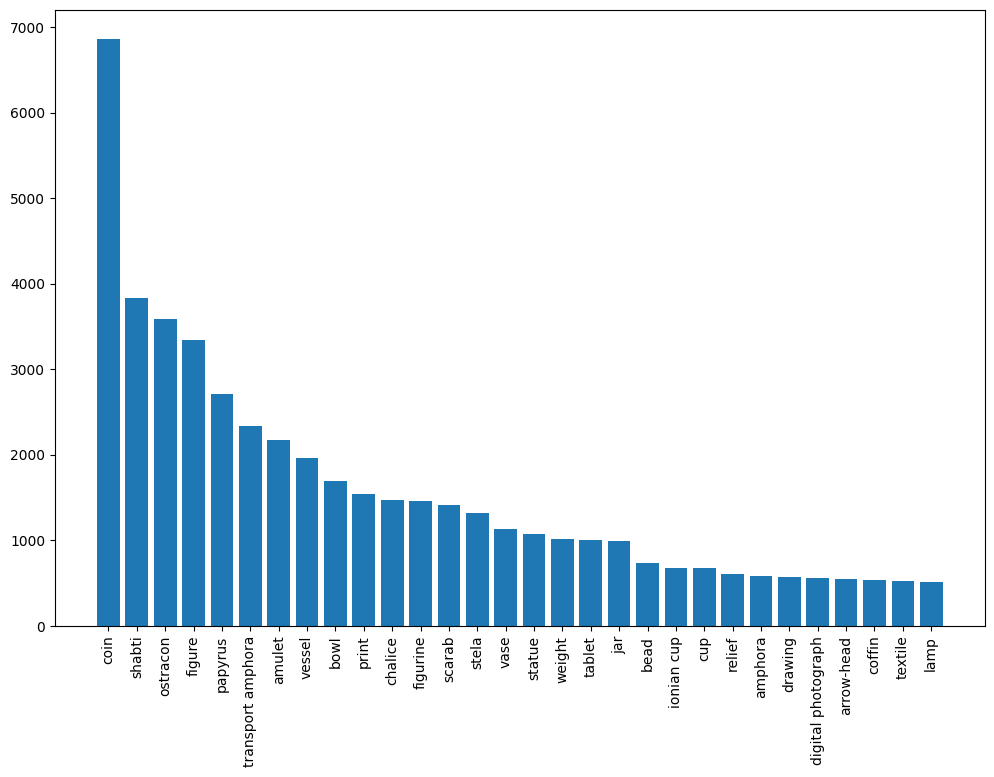

In [22]:
top30_pbject = print_value_count(df, "object_classification", 30)

### `Visualize the object types`

coin 6857


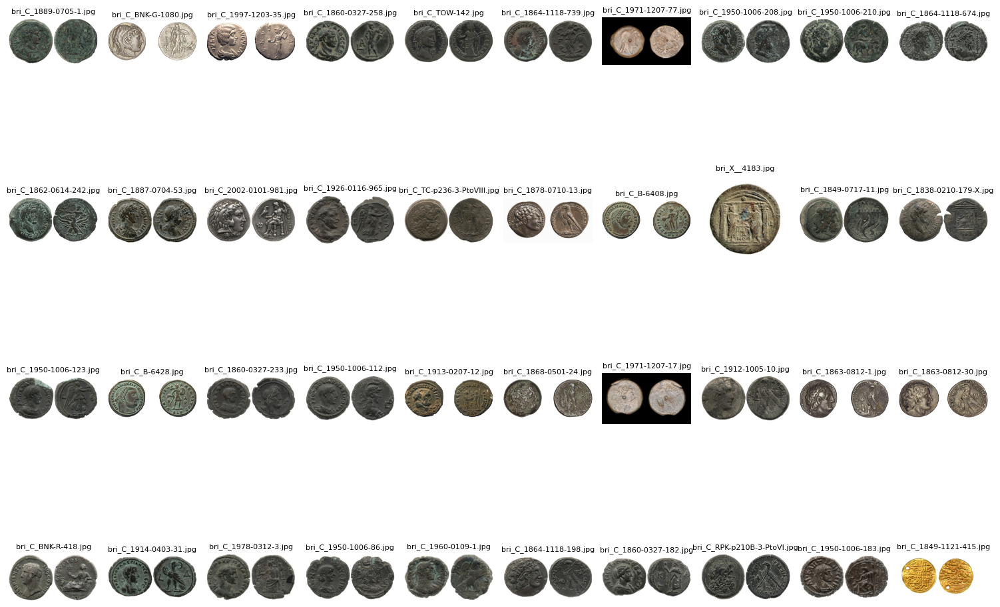

shabti 3837


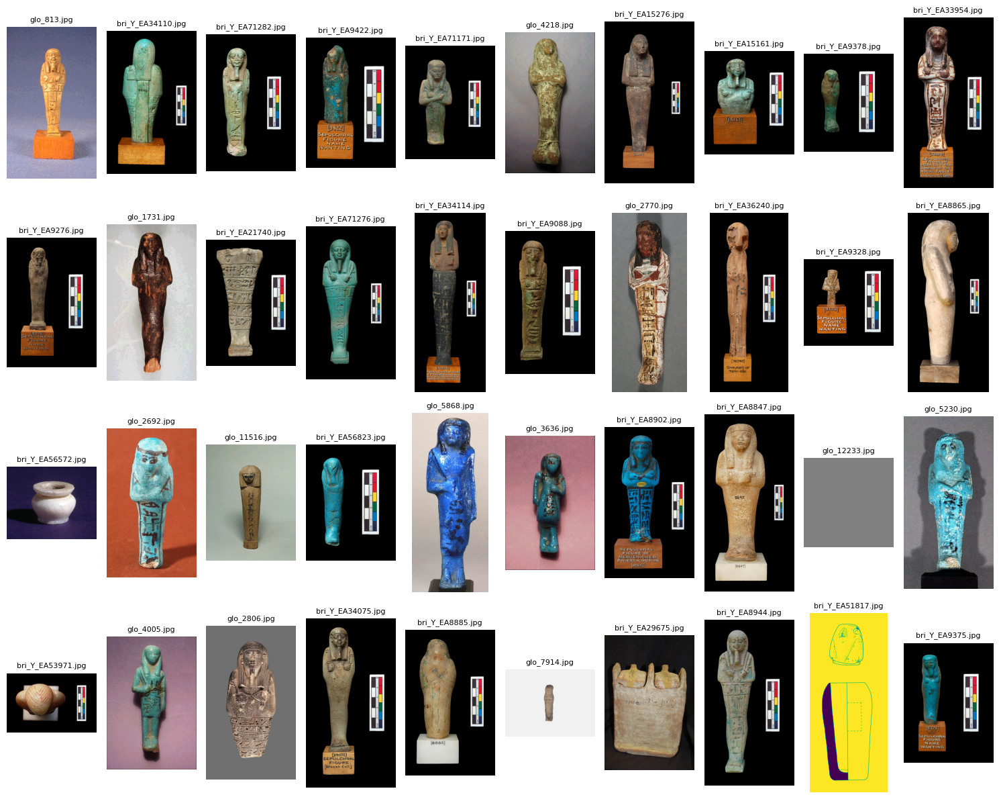

ostracon 3591


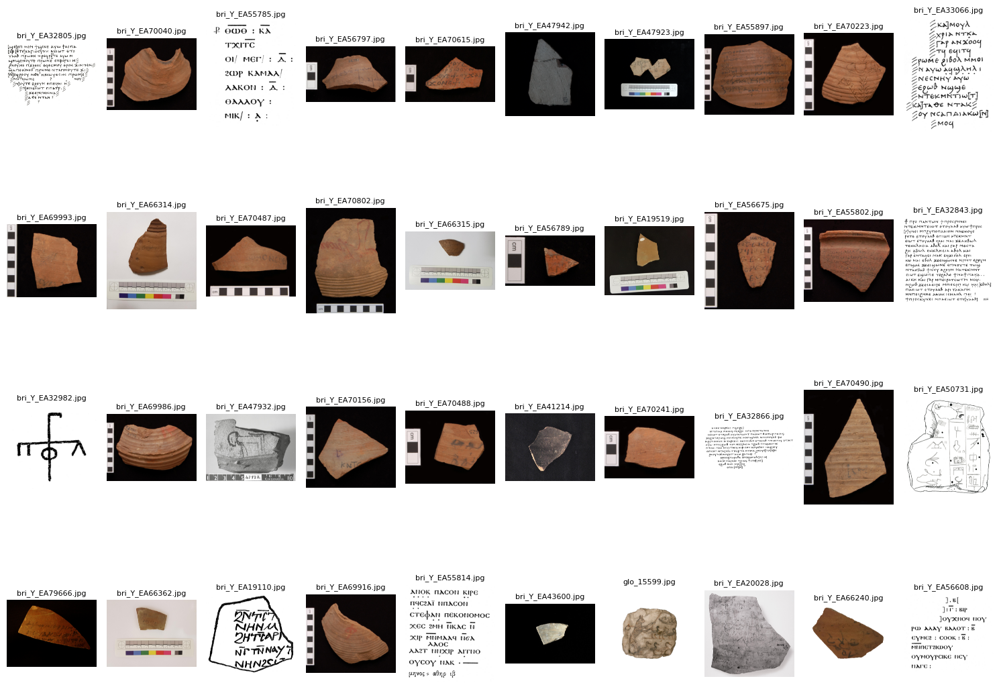

figure 3337


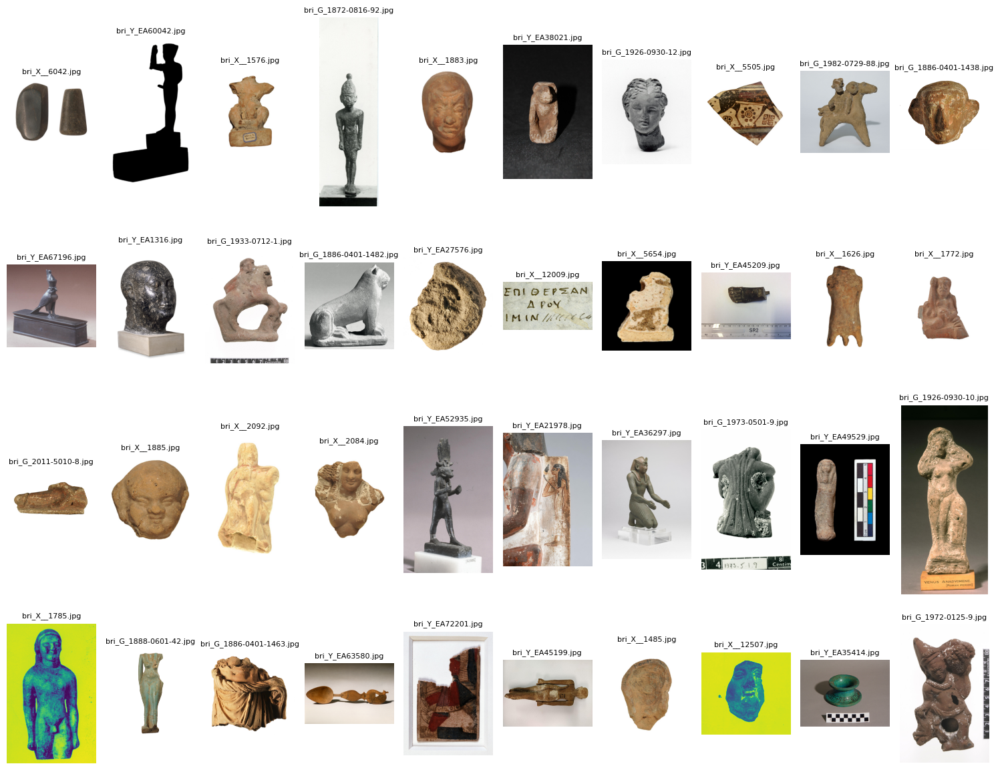

papyrus 2713


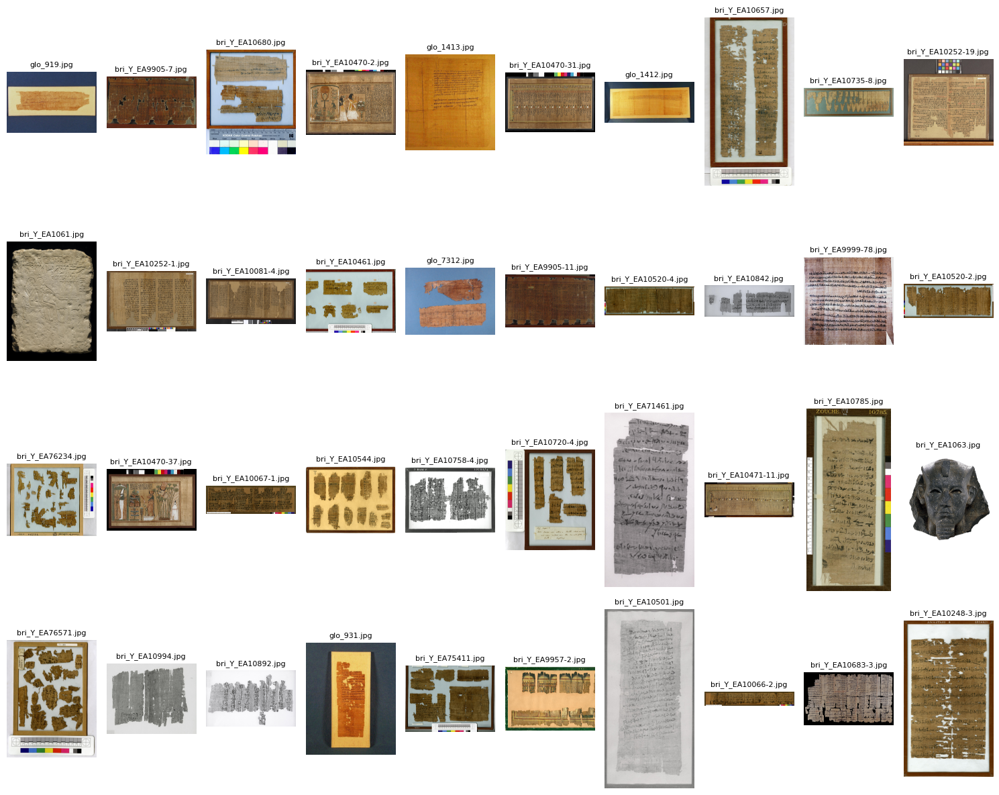

transport amphora 2342


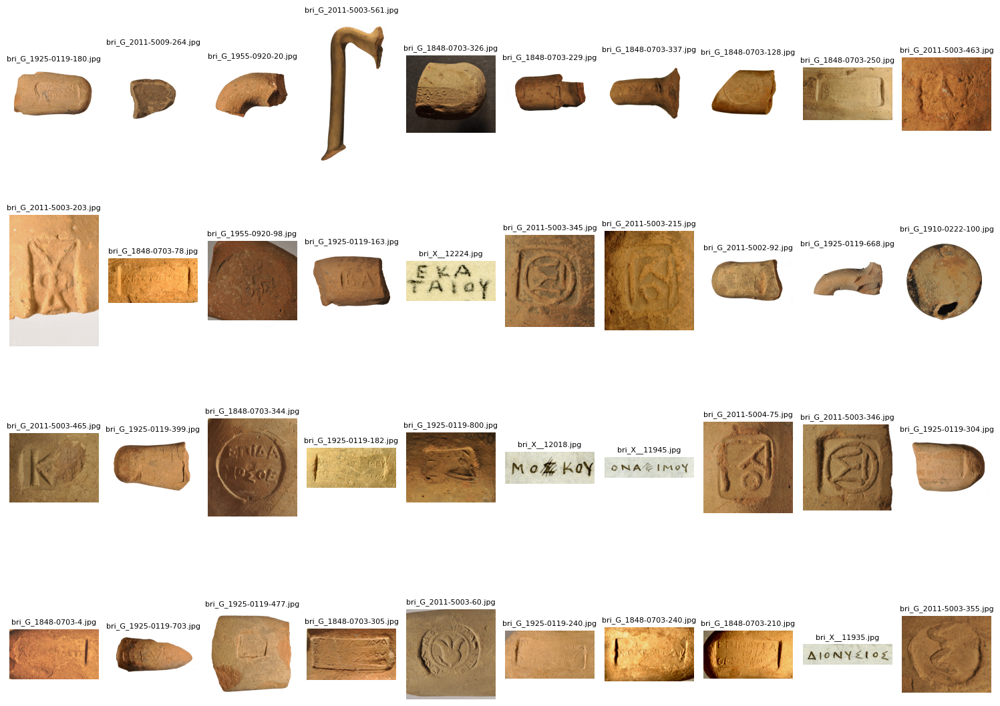

amulet 2176


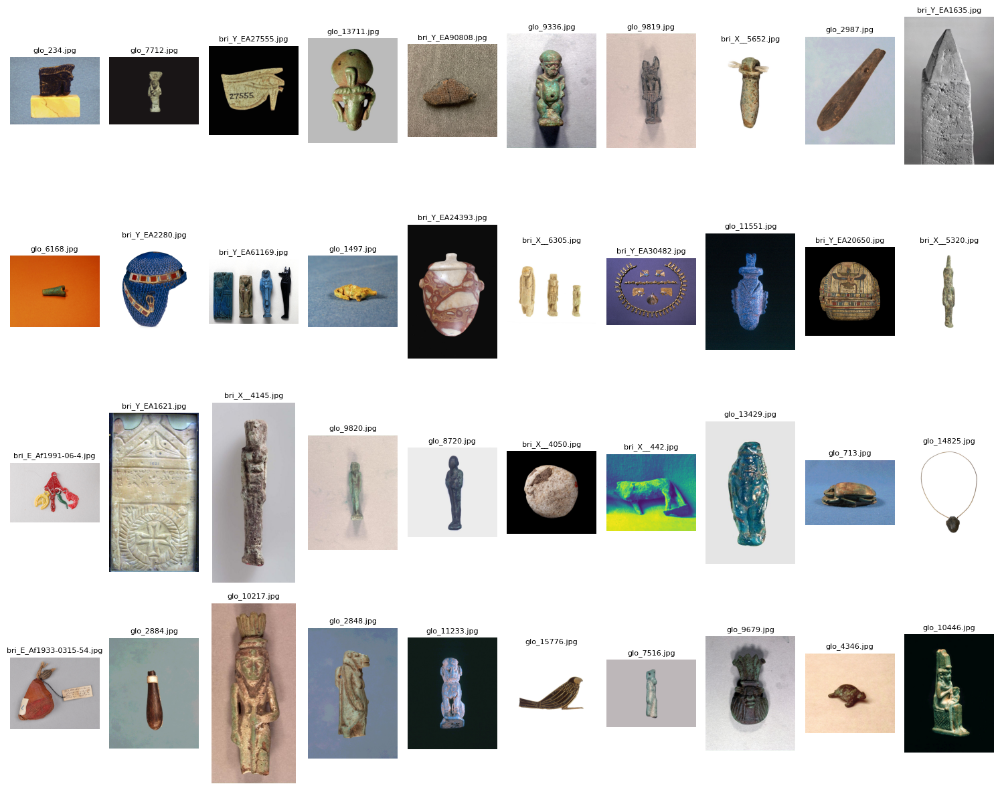

vessel 1965


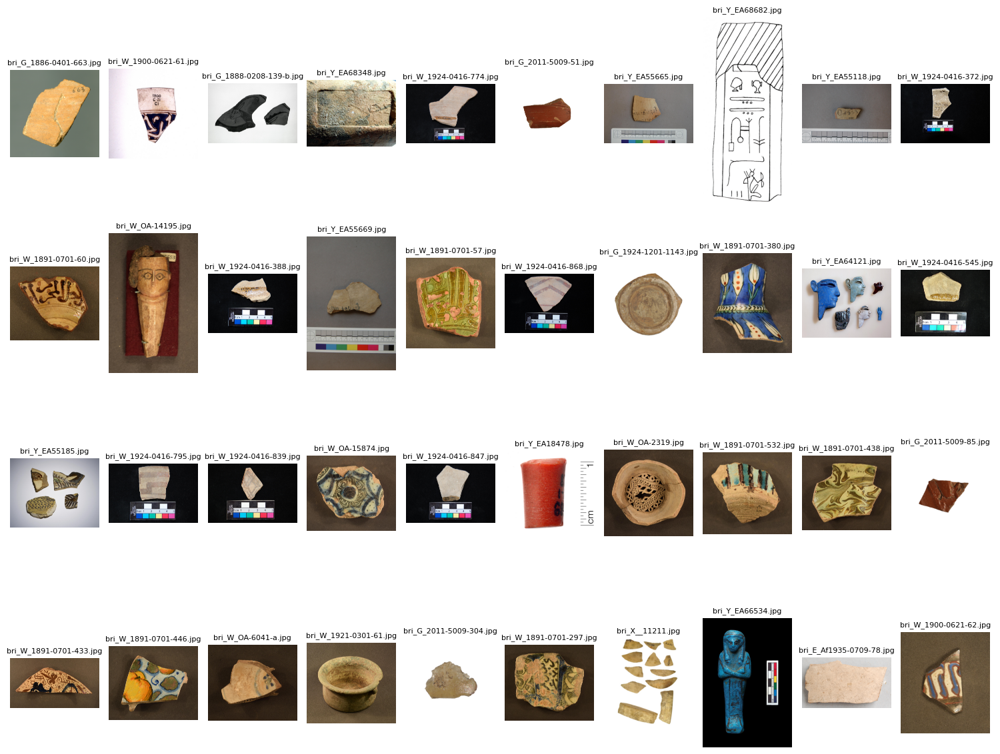

bowl 1694


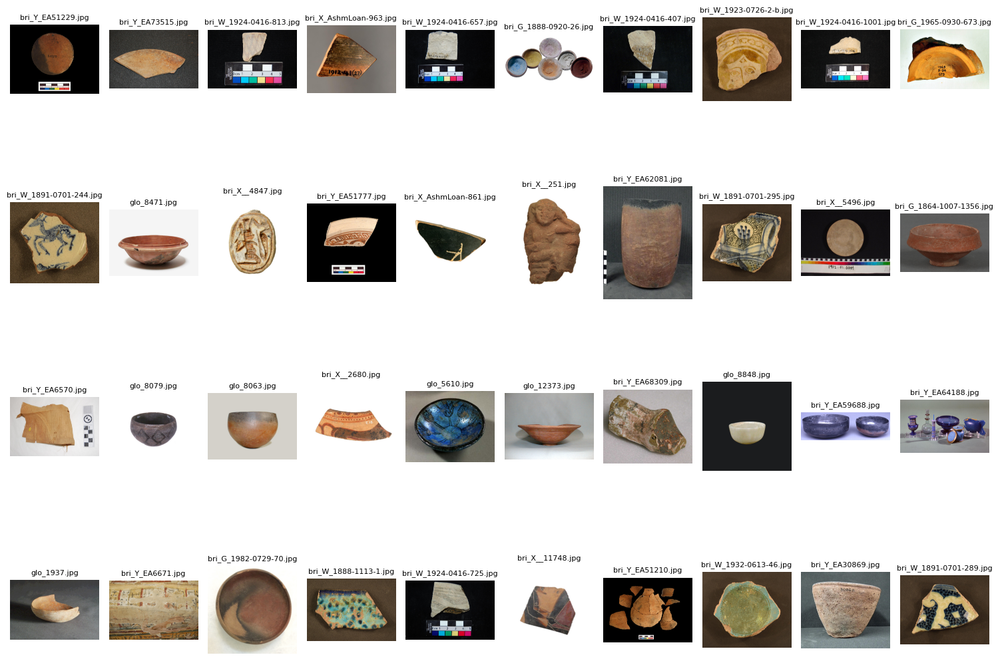

print 1541


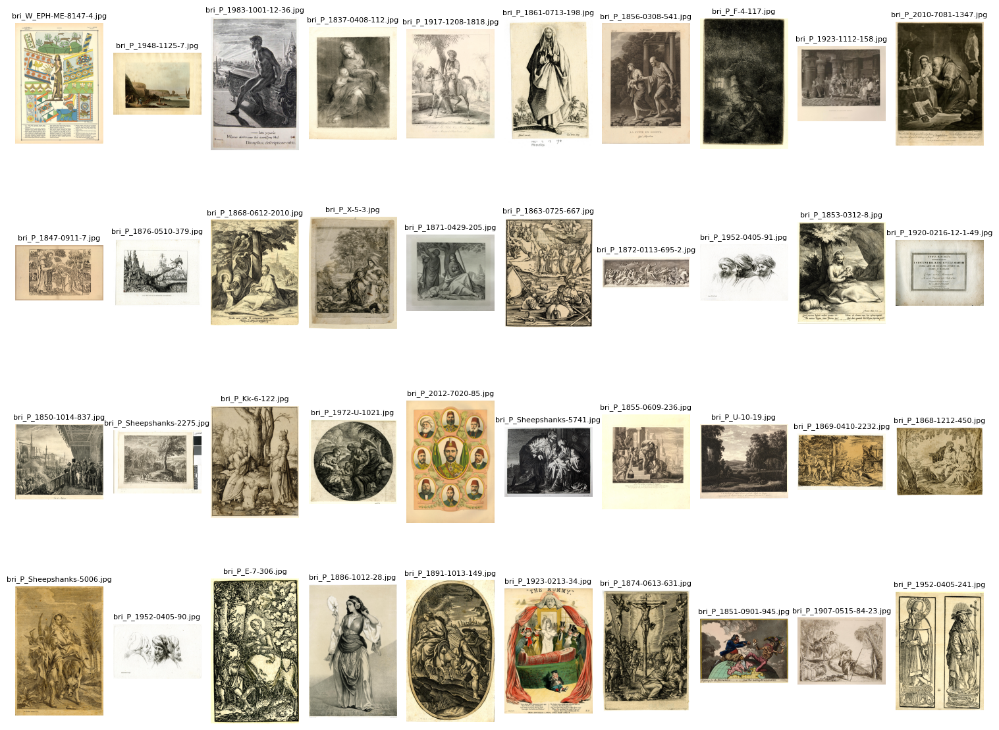

chalice 1468


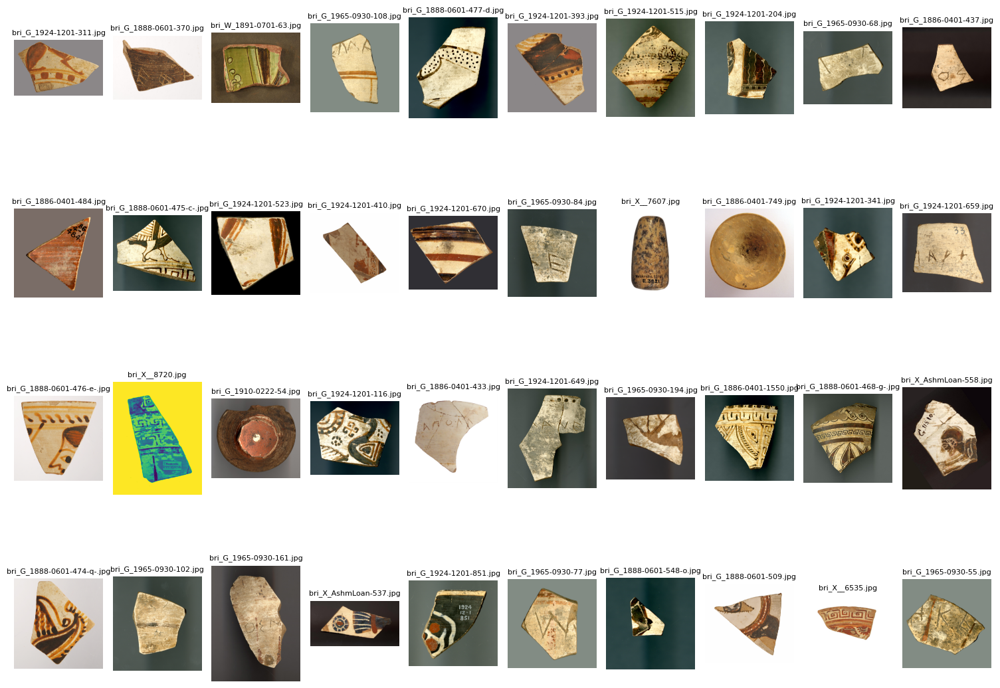

figurine 1455
Error loading image at index 60517: cannot identify image file 'd:\\My_working_area\\University\\Machine Intelligence\\PROJECT\\GITHUB2\\Museum-Artifacts-Categorization\\ScrappingScripts\\Combining_Museums\\..\\GlobalEgyptianMuseum\\photo\\glo_13311.jpg'
Error loading image at index 60306: cannot identify image file 'd:\\My_working_area\\University\\Machine Intelligence\\PROJECT\\GITHUB2\\Museum-Artifacts-Categorization\\ScrappingScripts\\Combining_Museums\\..\\GlobalEgyptianMuseum\\photo\\glo_13121.jpg'
Error loading image at index 60860: cannot identify image file 'd:\\My_working_area\\University\\Machine Intelligence\\PROJECT\\GITHUB2\\Museum-Artifacts-Categorization\\ScrappingScripts\\Combining_Museums\\..\\GlobalEgyptianMuseum\\photo\\glo_13620.jpg'
Error loading image at index 60858: cannot identify image file 'd:\\My_working_area\\University\\Machine Intelligence\\PROJECT\\GITHUB2\\Museum-Artifacts-Categorization\\ScrappingScripts\\Combining_Museums\\..\\GlobalEgyp

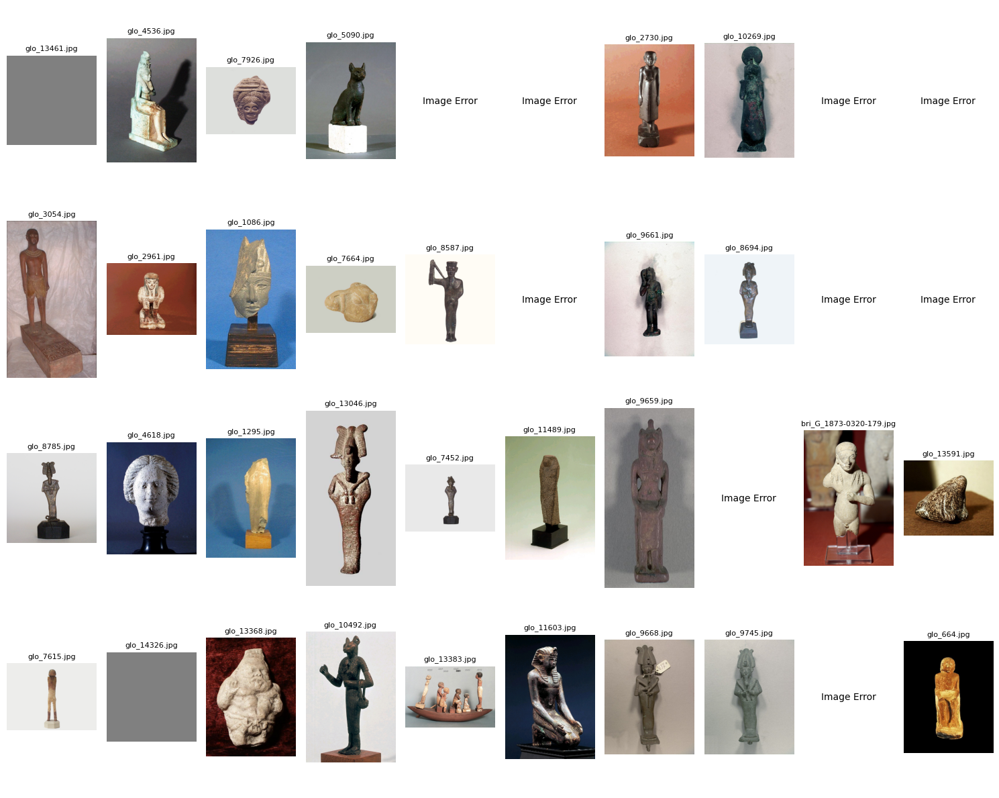

scarab 1409


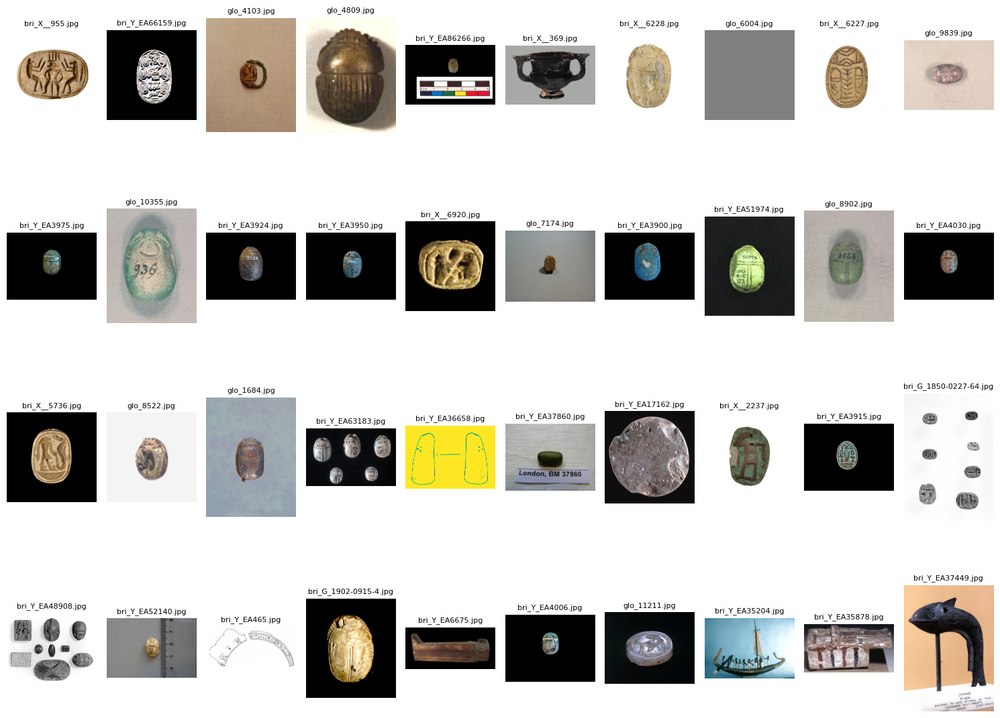

stela 1319


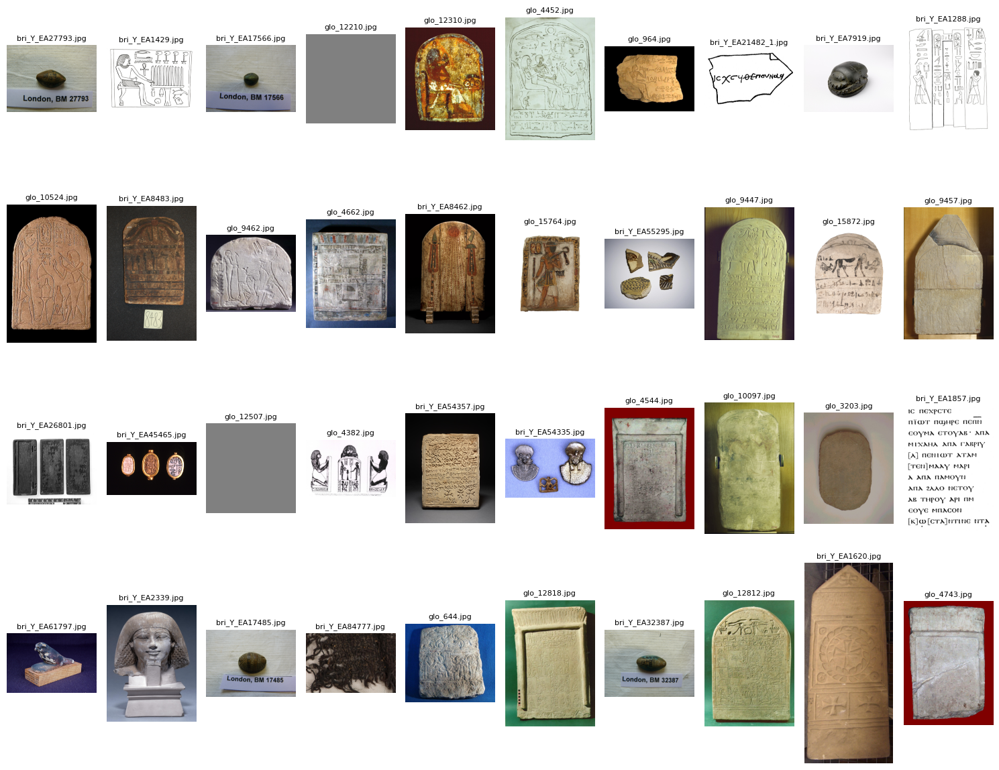

vase 1135


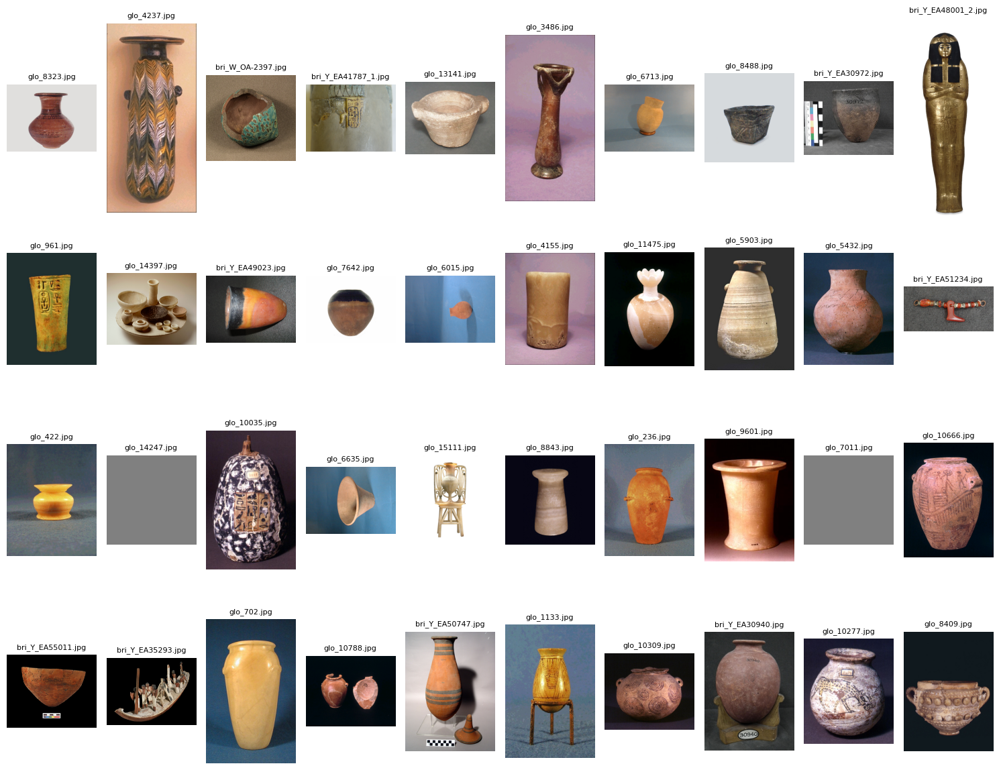

statue 1070
Error loading image at index 60289: cannot identify image file 'd:\\My_working_area\\University\\Machine Intelligence\\PROJECT\\GITHUB2\\Museum-Artifacts-Categorization\\ScrappingScripts\\Combining_Museums\\..\\GlobalEgyptianMuseum\\photo\\glo_13106.jpg'


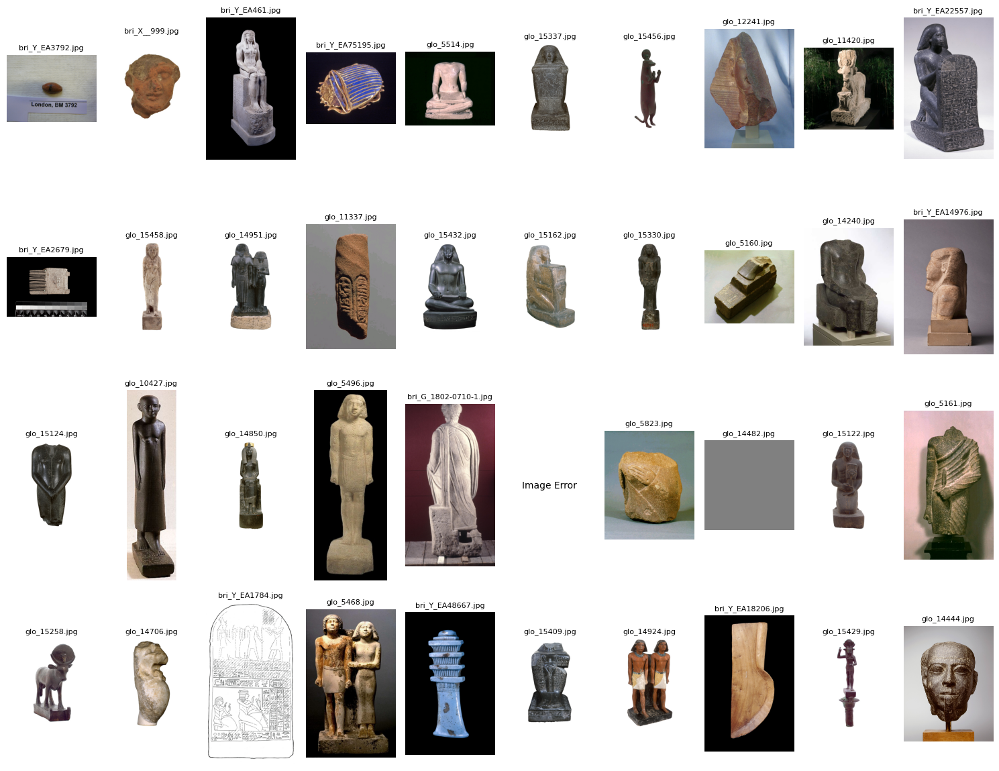

weight 1013


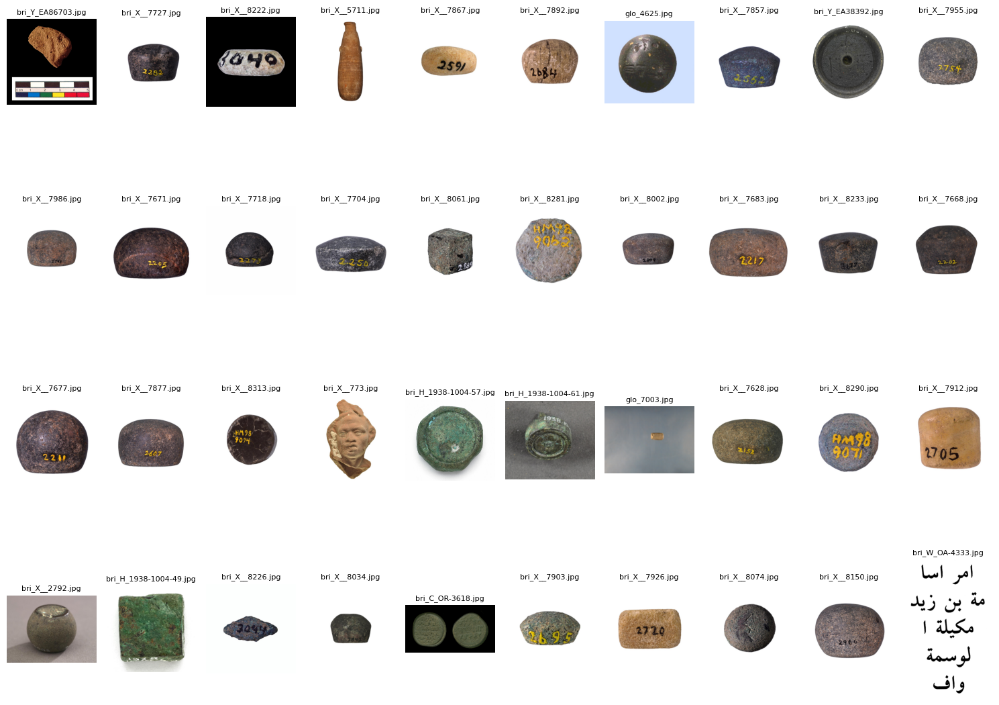

tablet 1004


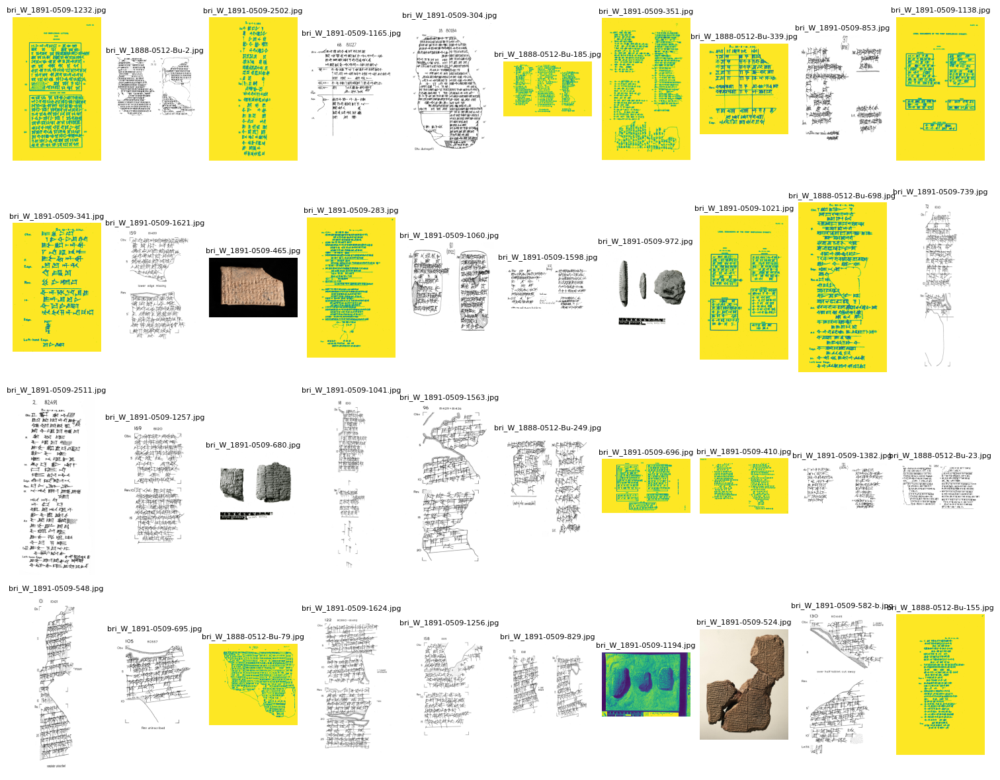

jar 998


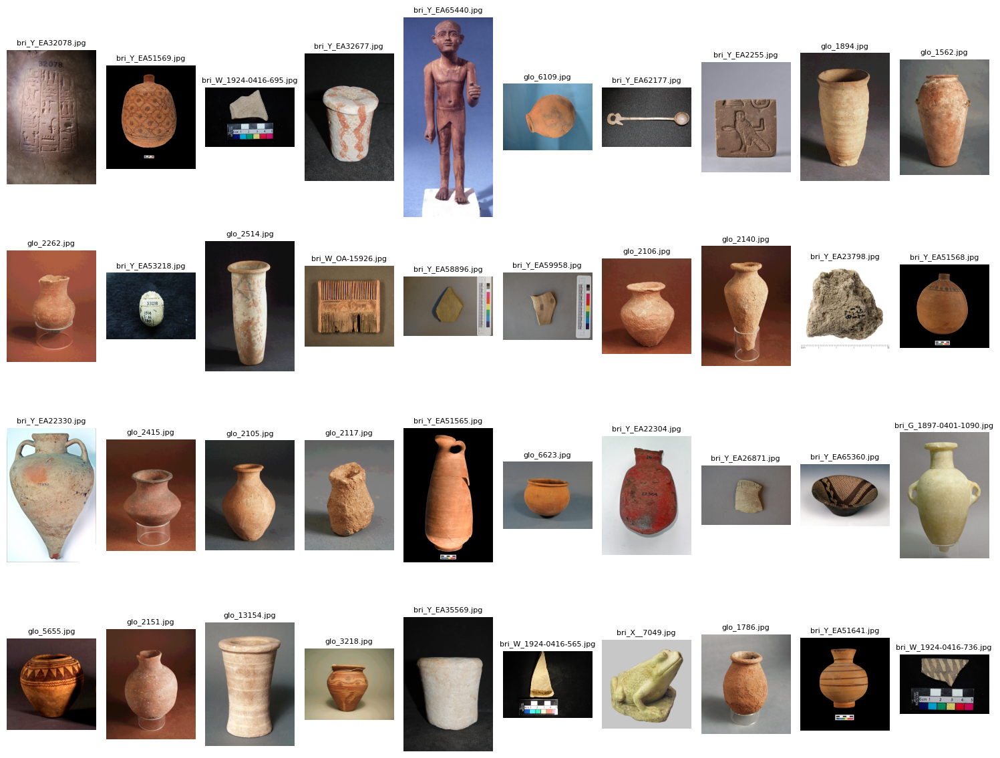

bead 737
Error loading image at index 60272: cannot identify image file 'd:\\My_working_area\\University\\Machine Intelligence\\PROJECT\\GITHUB2\\Museum-Artifacts-Categorization\\ScrappingScripts\\Combining_Museums\\..\\GlobalEgyptianMuseum\\photo\\glo_13091.jpg'
Error loading image at index 60250: cannot identify image file 'd:\\My_working_area\\University\\Machine Intelligence\\PROJECT\\GITHUB2\\Museum-Artifacts-Categorization\\ScrappingScripts\\Combining_Museums\\..\\GlobalEgyptianMuseum\\photo\\glo_13071.jpg'


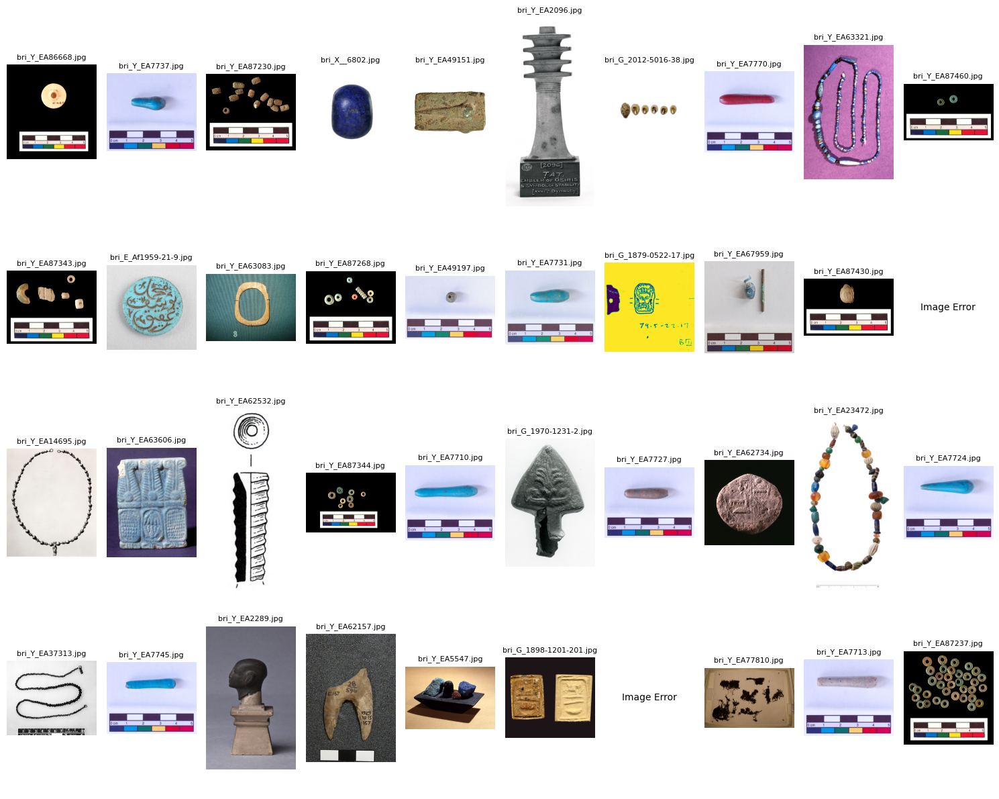

ionian cup 680


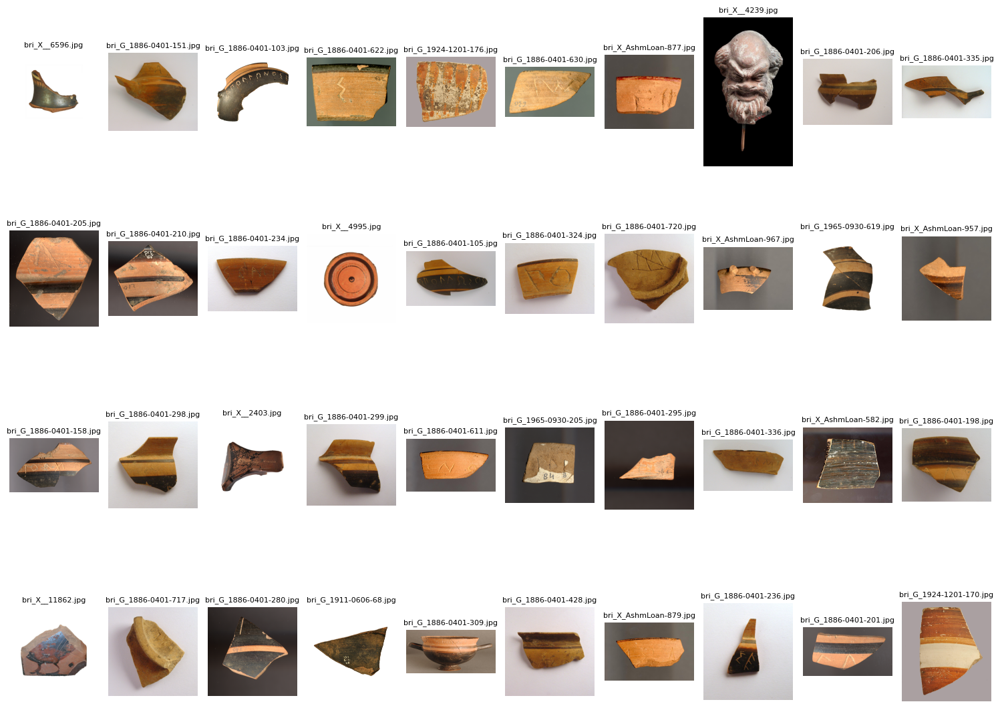

cup 674


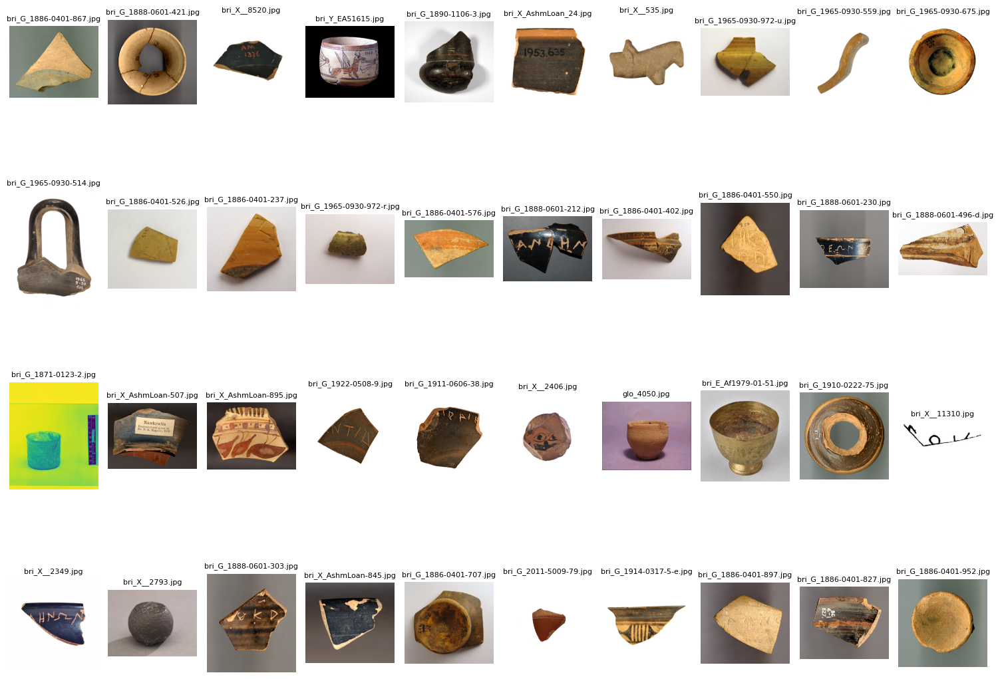

relief 606


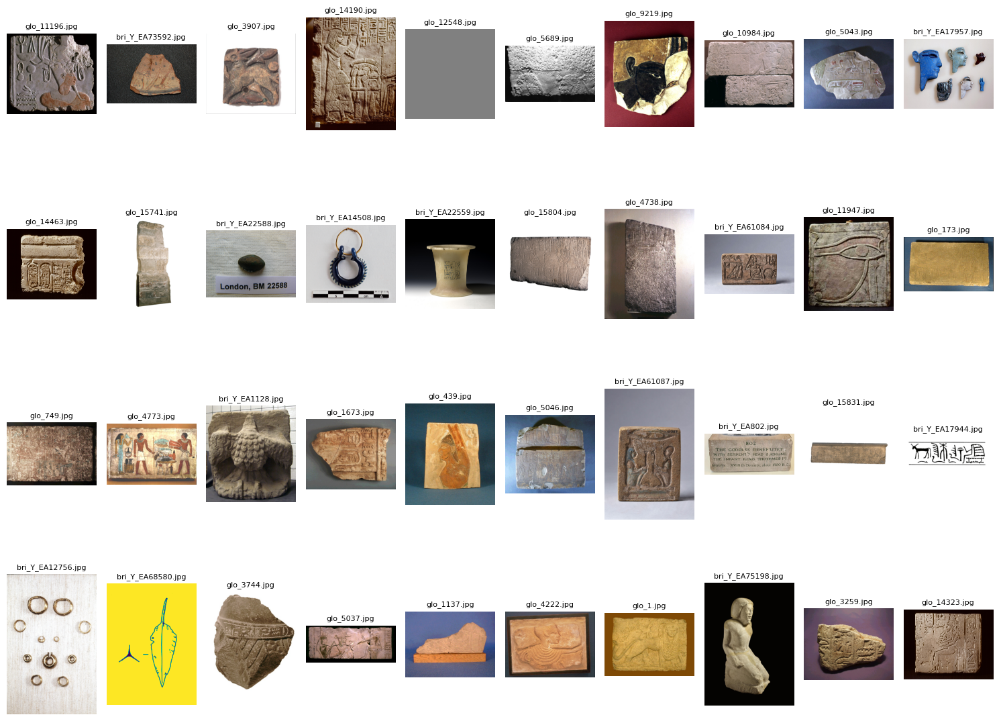

amphora 587


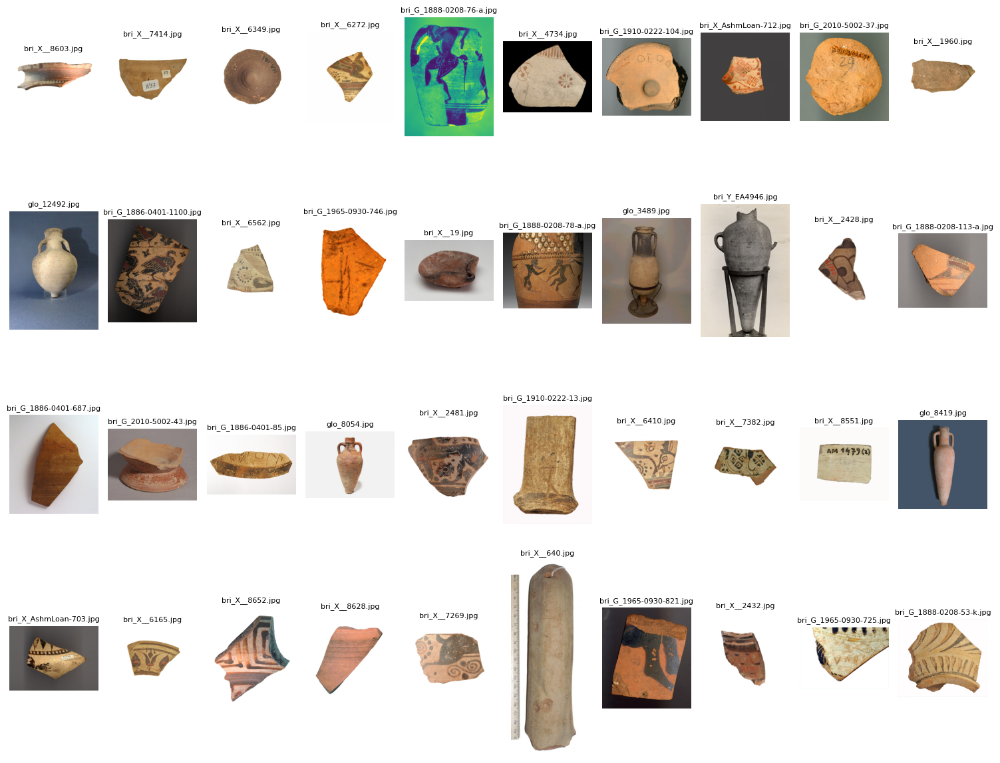

drawing 576


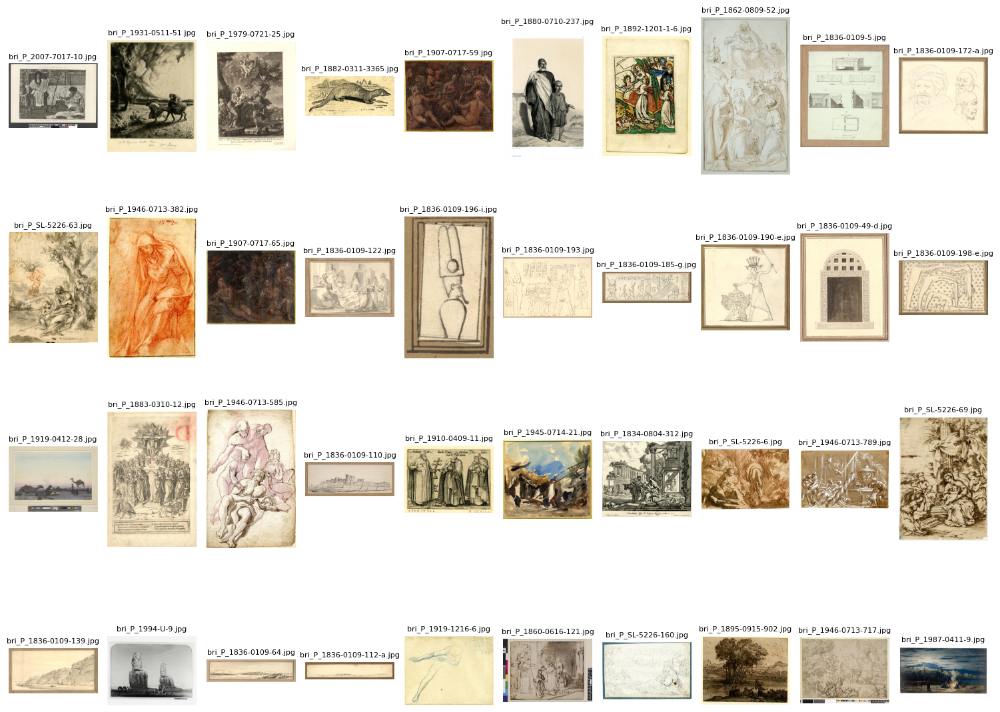

digital photograph 564


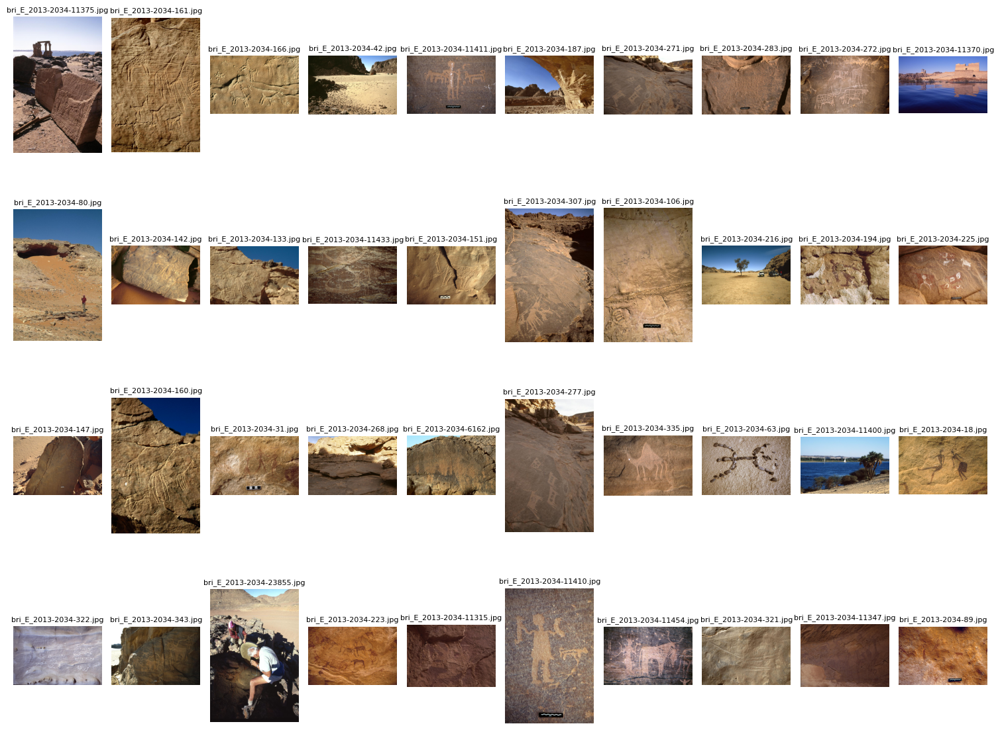

arrow-head 546


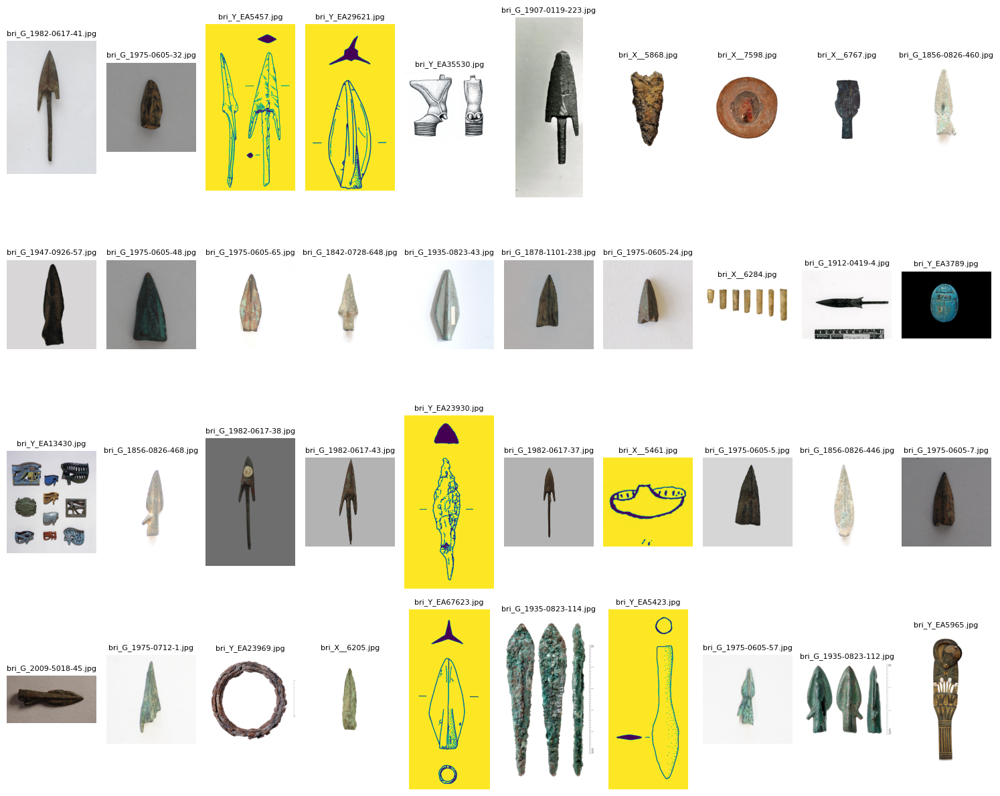

coffin 536


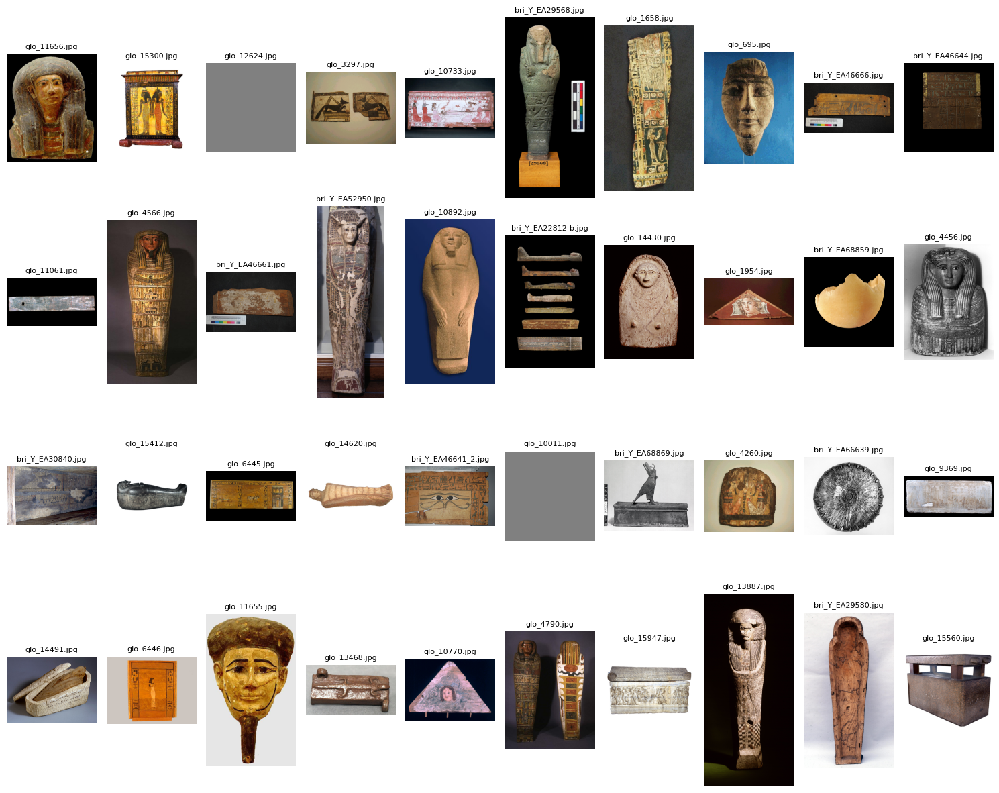

textile 523


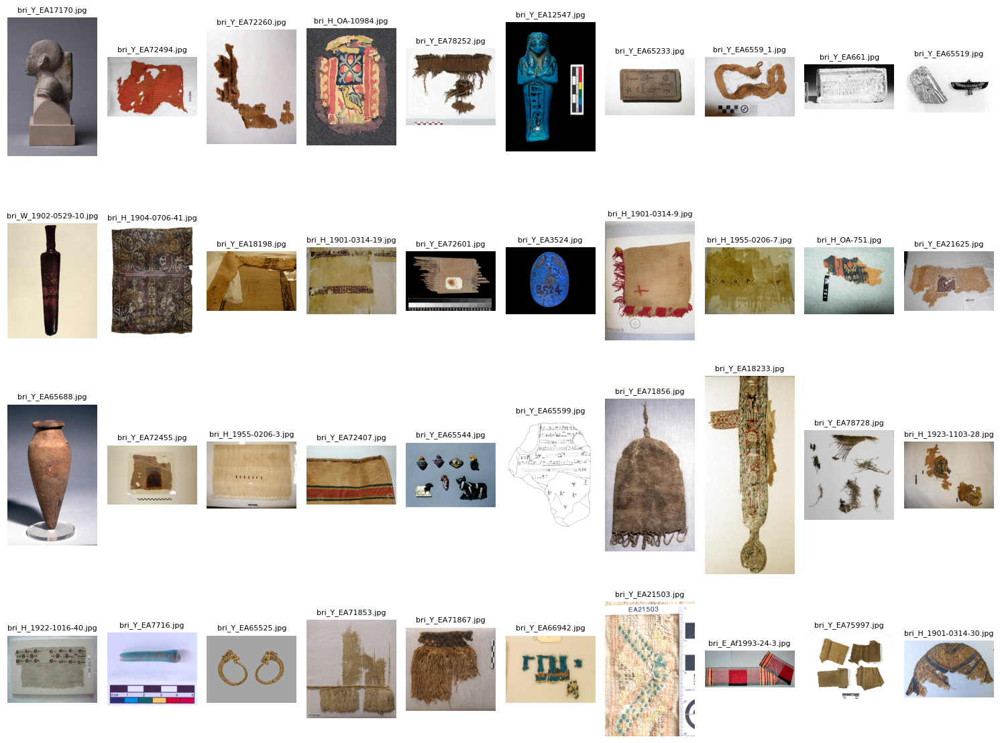

lamp 509


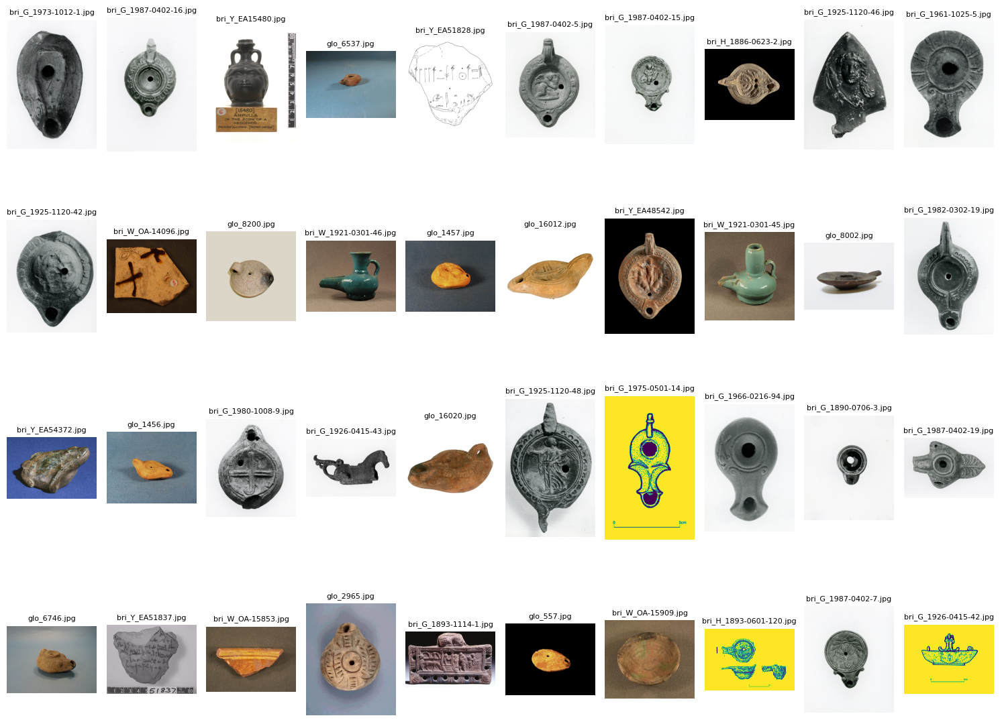

In [23]:
for i in top30_pbject:
    show_images(df,"object_classification", i)

### `Combine similar objects`

In [24]:
top30_pbject

Index(['coin', 'shabti', 'ostracon', 'figure', 'papyrus', 'transport amphora',
       'amulet', 'vessel', 'bowl', 'print', 'chalice', 'figurine', 'scarab',
       'stela', 'vase', 'statue', 'weight', 'tablet', 'jar', 'bead',
       'ionian cup', 'cup', 'relief', 'amphora', 'drawing',
       'digital photograph', 'arrow-head', 'coffin', 'textile', 'lamp'],
      dtype='object', name='object_classification')

In [25]:
combine_values(df, "object_classification", ['ostracon','transport amphora','bowl', 'chalice','ionian cup', 'cup', 'jar', 'amphora', 'vase', 'vessel' ], "vessel") # combined all the items that are like containers
combine_values(df, "object_classification", ['shabti','figure', 'figurine', 'statue' ], "statue") #all are status of faces 
combine_values(df,"object_classification", ['stela','relief','papyrus' ], "inscription" ) #combined all materials that have written text on
combine_values(df, "object_classification", ['print', 'drawing'], "art") # both are art pieces drawn in similar style
combine_values(df, "object_classification", ['amulet', 'scarab', 'bead', 'ear-rings'], "accessories")

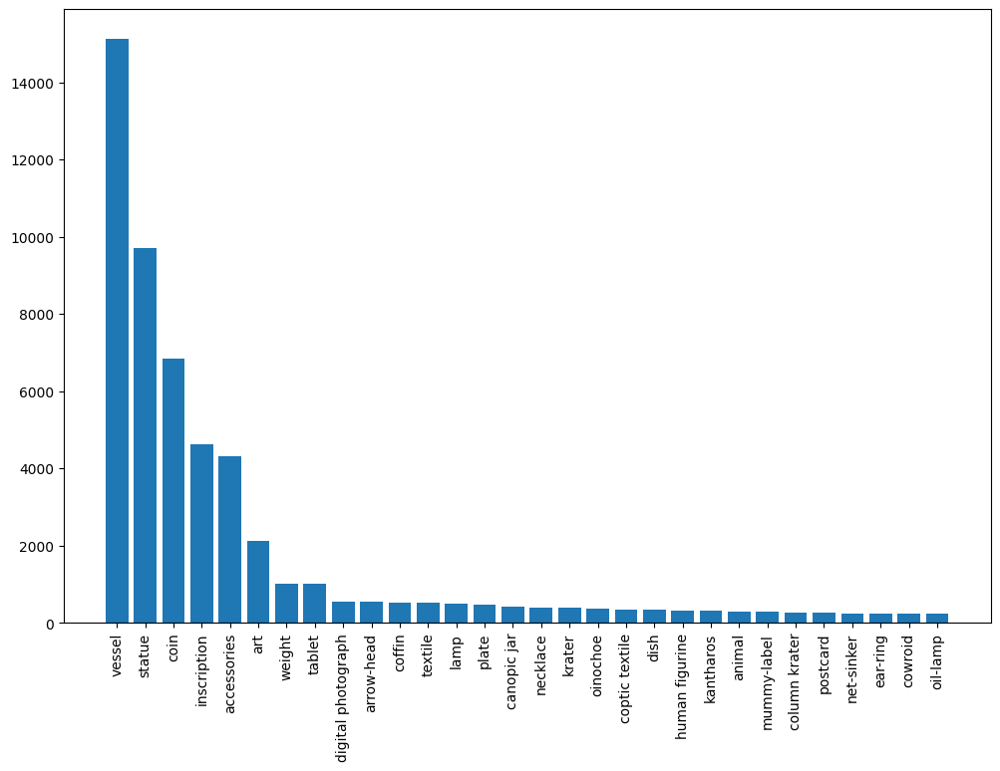

In [26]:
top30_object_new = print_value_count(df, "object_classification", 30)

In [27]:
df.to_csv("cleaned_object_classification.csv")

## `Material`

In [28]:
df = pd.read_csv("cleaned_object_classification.csv")

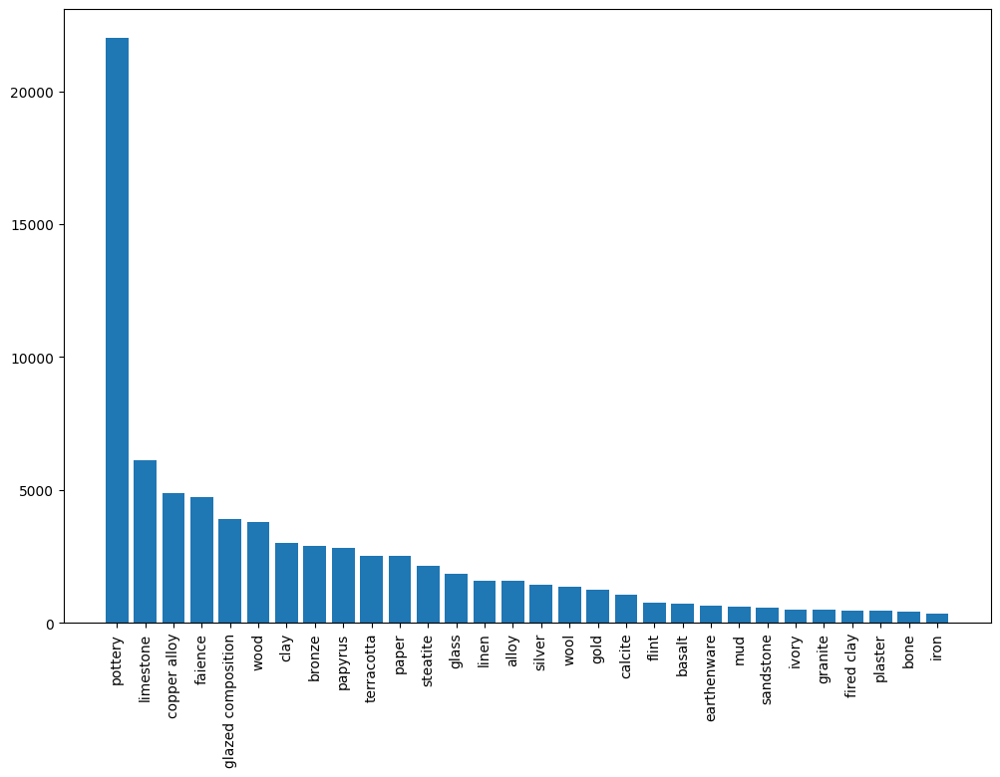

In [29]:
top30_material = print_value_count(df, "material", 30)

pottery 21999
Error loading image at index 14950: too many indices for array: array is 1-dimensional, but 2 were indexed
ERROR: too many indices for array: array is 1-dimensional, but 2 were indexed
limestone 6110
Error loading image at index 80515: too many indices for array: array is 1-dimensional, but 2 were indexed
ERROR: too many indices for array: array is 1-dimensional, but 2 were indexed
copper alloy 4888
Error loading image at index 29747: too many indices for array: array is 1-dimensional, but 2 were indexed
ERROR: too many indices for array: array is 1-dimensional, but 2 were indexed
faience 4726
Error loading image at index 66992: too many indices for array: array is 1-dimensional, but 2 were indexed
ERROR: too many indices for array: array is 1-dimensional, but 2 were indexed
glazed composition 3896
Error loading image at index 55670: too many indices for array: array is 1-dimensional, but 2 were indexed
ERROR: too many indices for array: array is 1-dimensional, but 2 were

C:\Users\maria\AppData\Local\Temp\ipykernel_24076\485556152.py:13: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axes = plt.subplots(num_rows, num_images_per_row, figsize=(15, 3 * num_rows))


Error loading image at index 28485: too many indices for array: array is 1-dimensional, but 2 were indexed
ERROR: too many indices for array: array is 1-dimensional, but 2 were indexed
earthenware 659
Error loading image at index 74414: too many indices for array: array is 1-dimensional, but 2 were indexed
ERROR: too many indices for array: array is 1-dimensional, but 2 were indexed
mud 617
Error loading image at index 82802: too many indices for array: array is 1-dimensional, but 2 were indexed
ERROR: too many indices for array: array is 1-dimensional, but 2 were indexed
sandstone 551
Error loading image at index 44226: too many indices for array: array is 1-dimensional, but 2 were indexed
ERROR: too many indices for array: array is 1-dimensional, but 2 were indexed
ivory 495
Error loading image at index 21138: too many indices for array: array is 1-dimensional, but 2 were indexed
ERROR: too many indices for array: array is 1-dimensional, but 2 were indexed
granite 487
Error loading i

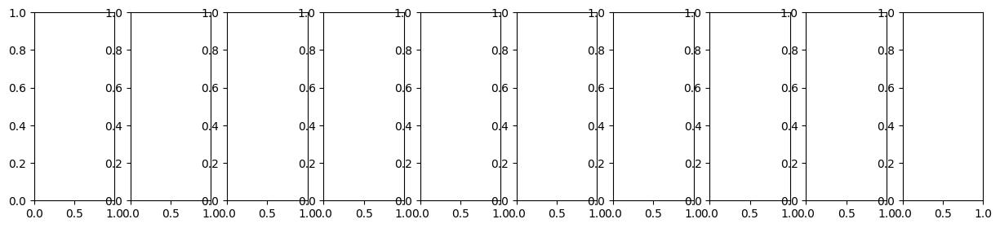

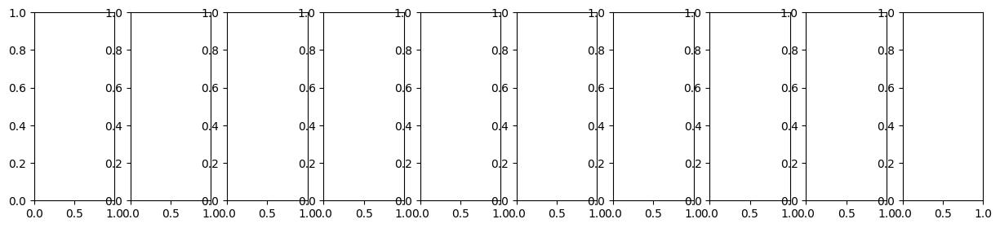

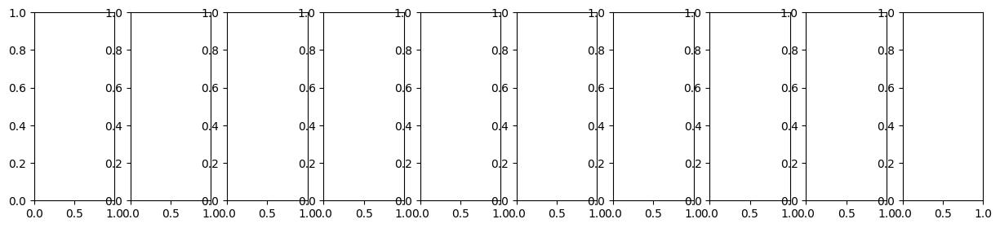

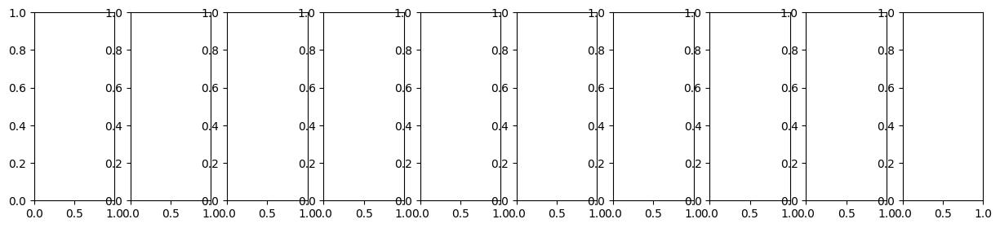

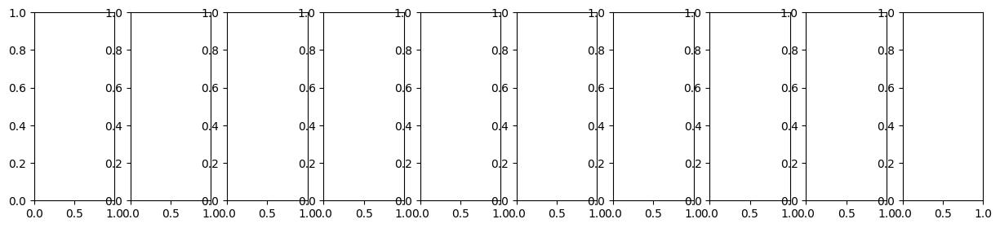

...

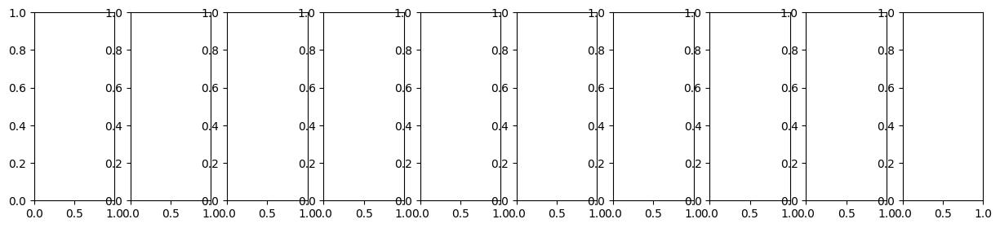

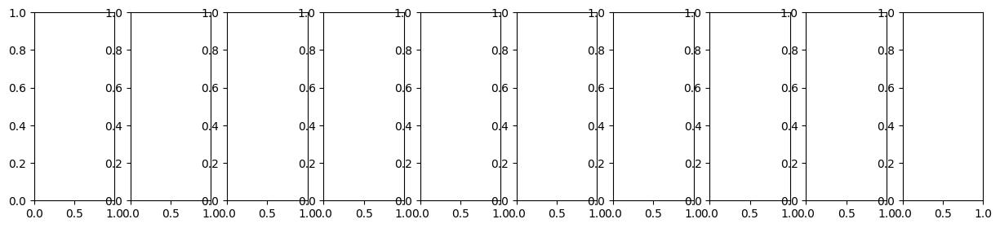

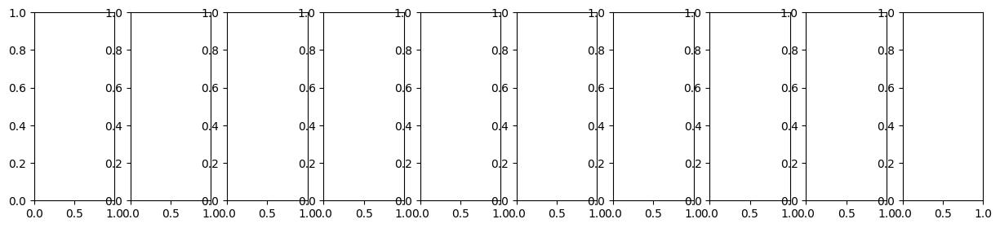

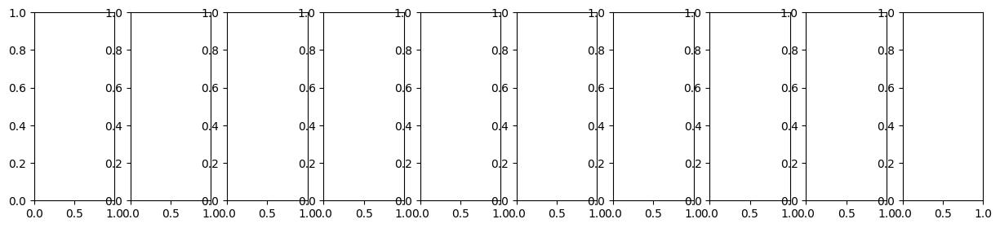

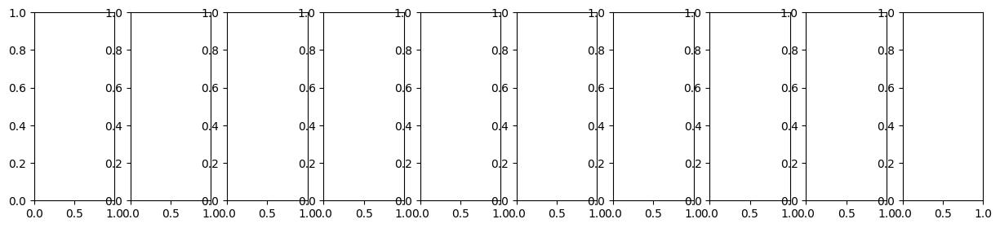

In [30]:
for i in list(top30_material):
    show_images(df, "material",i, num_rows=1)

## `Date`